Here I'm going to demonstrate the MADGICS component separation technique on two-dimensional, Gaussian-distributed data. Also, note that this notebook is in Julia.

In [1]:
using Plots
using LinearAlgebra
using Distributions
using LaTeXStrings

┌ Info: Precompiling Plots [91a5bcdd-55d7-5caf-9e0b-520d859cae80]
└ @ Base loading.jl:1664
┌ Info: Precompiling Distributions [31c24e10-a181-5473-b8eb-7969acd0382f]
└ @ Base loading.jl:1664


Let's pretend we have two 2D variables with different shaped distributions.

In [2]:
mu = [0,0]
cov1 = [1 0; 0 1]
cov2 = [1 0.5; 0.5 1]
dist1 = MvNormal(mu, cov1)
dist2 = MvNormal(mu, cov2)

FullNormal(
dim: 2
μ: [0.0, 0.0]
Σ: [1.0 0.5; 0.5 1.0]
)


In [3]:
function plot_2d_dist(x; title="")
    plot(x[1,:], x[2,:], seriestype=:scatter, alpha = 0.2, title=title)
end

plot_2d_dist (generic function with 1 method)

Generate 10000 samples from each of them. The distributions look different.

In [7]:
samples1 = rand(dist1, 10000);
samples2 = rand(dist2, 10000);

p1 = plot(samples1[1,:], samples1[2,:], seriestype=:scatter, alpha = 0.2, title=L"x_1", legend=:none,titlefontsize=24)
p2 = plot(samples2[1,:], samples2[2,:], seriestype=:scatter, alpha = 0.2, title=L"x_2", legend=:none,titlefontsize=24)
p = plot(p1,p2, layout=(1,2), size=(1000,500))


Pretend there's a variable that is a sum of the original two 2D variables, and we only have data on that distribution. How can we recover the two components?

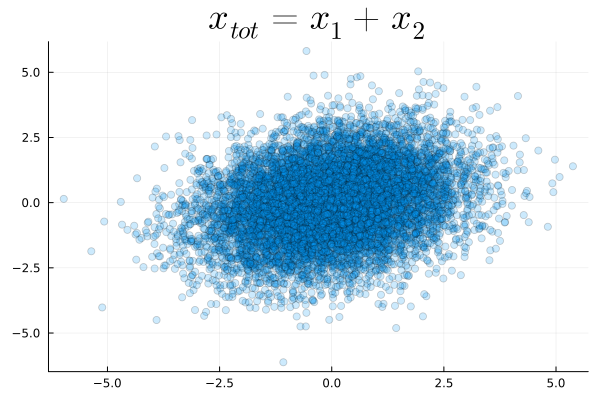

In [10]:
all_samples = samples1 + samples2
p3 = plot(all_samples[1,:], all_samples[2,:], seriestype=:scatter, alpha = 0.2, title=L"x_{tot} = x_1 + x_2", legend=:none,titlefontsize=24)

In [12]:
# p = plot(p1, p2, p3, layout=(1,3), size=(1500,500))

Maybe we can get only 100 samples of each component individually. We can use these to create a covariance for that component.

In [13]:
prior_samples1 = rand(dist1, 100)
prior_samples2 = rand(dist2, 100)

random_matrix=[50 -6; 6 27]

datacov1 = prior_samples1 * prior_samples1' ./ size(prior_samples1,2)
datacov2 = prior_samples2 * prior_samples2' ./ size(prior_samples2,2)
# datacov1 = datacov1*random_matrix
# datacov2 = datacov2*random_matrix


Ctotinv = inv(cholesky((datacov1 + datacov2)));
# Ctotinv = inv((datacov1 + datacov2));

Now, we can use these to recover the original components in the combined data. 

In [15]:
recovered_data1 = datacov1 * Ctotinv * all_samples
p1 = plot(samples1[1,:], samples1[2,:], seriestype=:scatter, alpha = 0.2, label=L"x_1"*" samples")
plot!(p1, recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha = 0.2, label="component 1")

recovered_data2 = datacov2 * Ctotinv * all_samples
p2 = plot(samples2[1,:], samples2[2,:], seriestype=:scatter, alpha = 0.2, label=L"x_2"*" samples")
plot!(p2, recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha = 0.2, label="component 2")

p = plot(p1,p2, layout=(1,2), size=(1000,500))


We can show that the components add up to the original data.

In [275]:
all_recovered_data = recovered_data1 + recovered_data2
# plot(all_recovered_data[1,:], all_recovered_data[2,:], seriestype=:scatter, alpha=0.2)

2×10000 Matrix{Float64}:
 -0.49653  -1.20526   1.07616  -0.0504392  …   2.88145   -1.21443  -2.63902
  1.61868   2.06483  -1.06135   1.01756       -0.143688  -0.39677  -0.132273

In [108]:
sum(abs.(all_recovered_data .- all_samples))

3.740868725898849e-12

--------------------------

MADGICS can hold under linear transformations.

In [16]:
function linear_transformation(x, A)
    return A * x
end

linear_transformation (generic function with 1 method)

In [17]:
function inverse_linear_transformation(y, A)
    return inv(A) * y
end

inverse_linear_transformation (generic function with 1 method)

MADGICS holds under linear transformations.

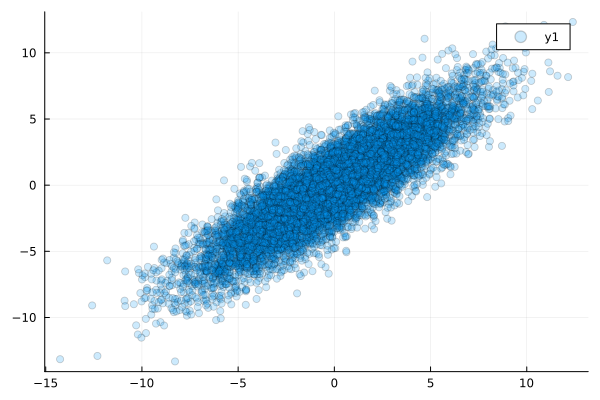

In [18]:
A = [2 1; 1 2]
transformed_total_samples = linear_transformation(all_samples, A)
plot(transformed_total_samples[1,:], transformed_total_samples[2,:], seriestype=:scatter, alpha=0.2)

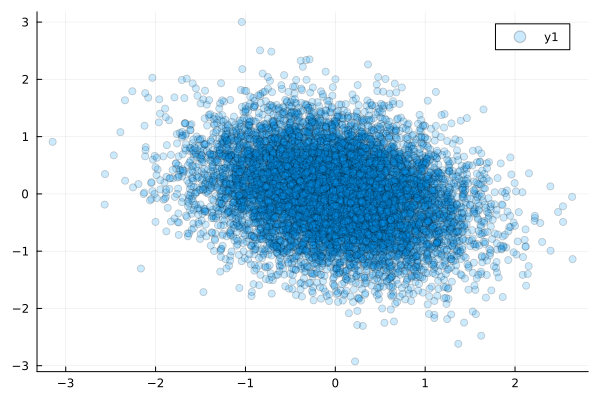

In [21]:
transformed_cov1 = A * datacov1 * A'
transformed_cov2 = A * datacov2 * A'

transformed_Ctotinv = inv(cholesky((transformed_cov1 + transformed_cov2)));
transformed_recovered_data1 = transformed_cov1 * transformed_Ctotinv * transformed_total_samples
transformed_recovered_data2 = transformed_cov2 * transformed_Ctotinv * transformed_total_samples

recovered_data1 = inverse_linear_transformation(transformed_recovered_data1, A)
recovered_data2 = inverse_linear_transformation(transformed_recovered_data2, A)

all_recovered_data = recovered_data1 + recovered_data2

plot(recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha=0.2)

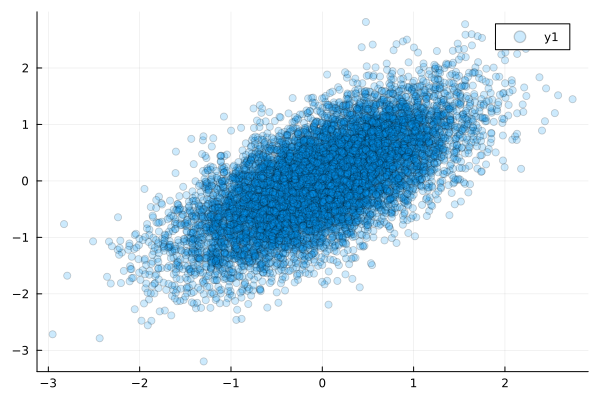

In [20]:
plot(recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha=0.2)

In [22]:
sum(abs.(all_recovered_data.- all_samples))

1.3516215056907921e-11

Now, what if we make the transformation slightly nonlinear?

In [23]:
function slightly_nonlinear_function(x1, x2, A; epsilon = -1.5)
   return A * x1 + (1 - epsilon) .* (A * x2)
end

slightly_nonlinear_function (generic function with 1 method)

In [24]:
new_transformed_all_samples = slightly_nonlinear_function(samples1, samples2, A)

2×10000 Matrix{Float64}:
  1.06327  4.5809   -6.38893  -8.6264   …  2.79996  1.82442  -0.453634
 -1.34176  6.21119  -1.88052  -6.76552     2.17371  2.74469  -3.27388

In [25]:
# plot_2d_dist(new_all_samples)

In [26]:
transformed_recovered_data1 = transformed_cov1 * transformed_Ctotinv * new_transformed_all_samples
transformed_recovered_data2 = transformed_cov2 * transformed_Ctotinv * new_transformed_all_samples

2×10000 Matrix{Float64}:
  0.322115  3.04542  -3.30991  -5.0533   …  1.63713  1.25035  -0.669108
 -0.528128  3.6798   -1.76418  -4.48084     1.44335  1.60011  -1.68475

In [27]:
recovered_data1 = inverse_linear_transformation(transformed_recovered_data1, A)
recovered_data2 = inverse_linear_transformation(transformed_recovered_data2, A)

2×10000 Matrix{Float64}:
  0.390786  0.803682  -1.61855    -1.87525  …  0.610302  0.300195   0.11551
 -0.459457  1.43806   -0.0728189  -1.30279     0.416523  0.649955  -0.900129

In [28]:
plot(recovered_data1[1,:], recovered_data1[2,:], seriestype=:scatter, alpha = 0.2, label="component 1")
plot!(recovered_data2[1,:], recovered_data2[2,:], seriestype=:scatter, alpha = 0.2, label="component 2")